In [12]:
from tsnecuda import TSNE
import matplotlib as mpl
import matplotlib.pyplot as plt
import pickle
import os
import seaborn as sns
import numpy as np
sns.set_theme()
import random


In [19]:
dname = 'airbnb'
feat_type = 'resnet152-imagenet'
submod_function = 'facility_location'
base_path = os.path.join(f"saved_stuff/processed_data/{dname}/{feat_type}/")
df = pickle.load(open(os.path.join(base_path, "processed_data.pkl"), 'rb'))

if dname == '20newsgroups':
    path_emb = os.path.join("saved_stuff/saved_embeddings/", dname, feat_type)
    embeddings = pickle.load(open(os.path.join(path_emb, "embeddings.pkl"), 'rb'))
elif dname == 'airbnb':
    embeddings = np.stack(df['feature'])
embeddings = np.nan_to_num(np.stack(embeddings))
print(embeddings.shape)
selected_points_idx = list(pickle.load(open(os.path.join(base_path, "selected_points.pkl"), 'rb')))
print(type(selected_points_idx))
#print(df['raw_text'][list(random.sample(range(0, 11096), 20))])
if dname == '20newsgroups': 
    print(df['raw_text'][selected_points_idx])

(864, 2048)


FileNotFoundError: [Errno 2] No such file or directory: 'saved_stuff/processed_data/airbnb/resnet152-imagenet/selected_points.pkl'

In [15]:

X_embedded = TSNE(n_components=2,perplexity=50, verbose = True).fit_transform(embeddings)

Initializing cuda handles... done.
KNN Computation... 

WARNING clustering 864 points to 29 centroids: please provide at least 1131 training points
WARNING clustering 864 points to 29 centroids: please provide at least 1131 training points
WARNING clustering 864 points to 29 centroids: please provide at least 1131 training points
WARNING clustering 864 points to 29 centroids: please provide at least 1131 training points


done.
Computing Pij matrix... 
done.
Initializing low dim points... done.
Initializing CUDA memory... done.
[Step 0] Avg. Gradient Norm: 0.00743275
[Step 10] Avg. Gradient Norm: 0.000475359
[Step 20] Avg. Gradient Norm: 4.12622e-05
[Step 30] Avg. Gradient Norm: 3.58828e-06
[Step 40] Avg. Gradient Norm: 3.16562e-07
[Step 50] Avg. Gradient Norm: 2.64234e-08
[Step 60] Avg. Gradient Norm: 2.52744e-09
[Step 70] Avg. Gradient Norm: 2.7101e-10
[Step 80] Avg. Gradient Norm: 5.69253e-10
[Step 90] Avg. Gradient Norm: 2.17151e-10
[Step 100] Avg. Gradient Norm: 1.85543e-10
[Step 110] Avg. Gradient Norm: 5.60014e-10
[Step 120] Avg. Gradient Norm: 4.88484e-10
[Step 130] Avg. Gradient Norm: 6.04235e-10
[Step 140] Avg. Gradient Norm: 3.86214e-10
[Step 150] Avg. Gradient Norm: 1.47429e-10
[Step 160] Avg. Gradient Norm: 2.45151e-10
[Step 170] Avg. Gradient Norm: 4.15817e-10
[Step 180] Avg. Gradient Norm: 1.01301e-09
[Step 190] Avg. Gradient Norm: 3.67471e-10
[Step 200] Avg. Gradient Norm: 8.22319e-10
[S

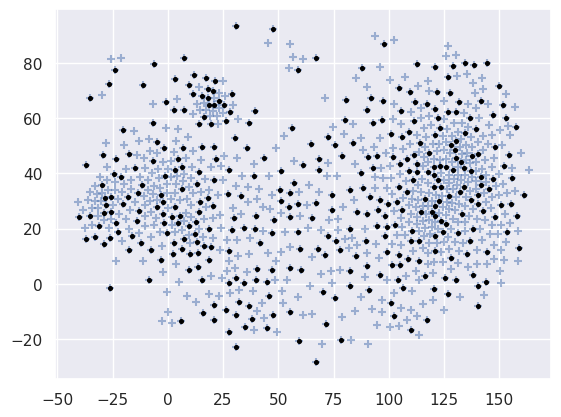

In [18]:
colors = ['green','blue','red','orange','purple','yellow','cyan','pink','gold','lawngreen']

x = X_embedded[:,0]
y = X_embedded[:,1]
selected_points = X_embedded[selected_points_idx]
x_selected = selected_points[:,0]
y_selected = selected_points[:, 1]

plt.scatter(x, y, alpha=0.5, marker='+')
plt.scatter(x_selected, y_selected, marker='o', color = 'black', s=7)


224 224


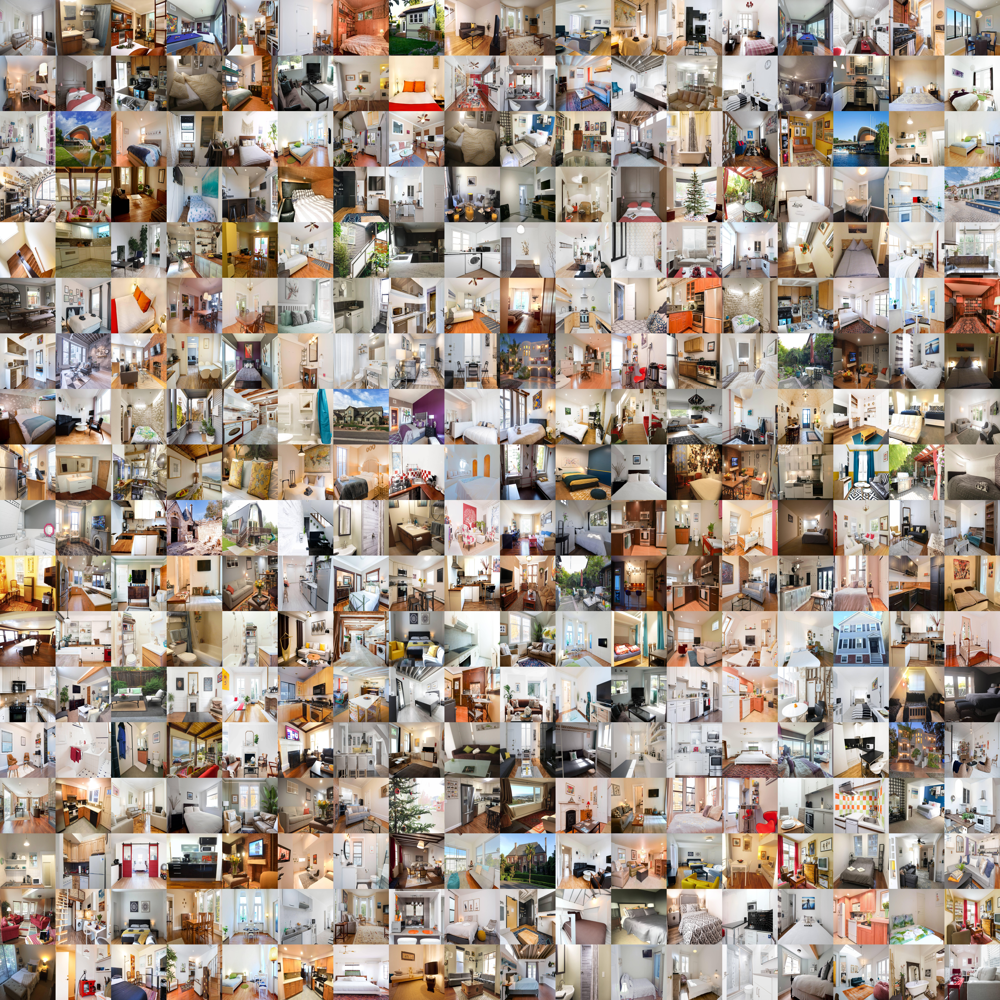

In [20]:
import pandas as pd
import random
from PIL import  Image

def image_grid(imgs_paths, base_path ,rows, cols, img_size = (224, 224), original = False):
    assert len(imgs_paths) == rows*cols
    img_list = []
    if img_size is not None:
        for img_path in imgs_paths:
            img_list.append(Image.open(os.path.join(base_path, img_path)).resize(img_size))

    w, h = img_list[0].size
    print(w,h)
    grid = Image.new('RGB', size=(cols*w, rows*h))

    grid_w, grid_h = grid.size
    
    for i, img in enumerate(img_list):
        if original:
            img = img.convert("RGB")
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid


# show random PIL Images
base_path = os.path.join("./downloaded_data/", "airbnb_data/images/") 
img_path = base_path
df = pd.DataFrame()
img_list_temp = os.listdir(img_path)
img_list = []
for x in img_list_temp:
    if x[0] != '.' and x[0] != '_':
        img_list.append(x)

df['img_path'] = img_list
n_data = len(img_list)

random_idxs = random.sample(range(0, n_data), 356)

img_list_random = list(np.array(img_list)[random_idxs])

image_grid(img_list_random[0:324], base_path ,rows = 18, cols= 18)
